<a href="https://colab.research.google.com/github/AndresSuquillo13mh/TP_08MBID/blob/main/08MBID_TP_Andres_Suquillo.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import numpy as np
import pandas as pd
import os
import seaborn as sns
import matplotlib.pyplot as plt
from scipy import stats
import warnings
warnings.filterwarnings('ignore')
import json
from datetime import datetime

In [2]:
from bokeh.io import output_notebook, show
from bokeh.plotting import figure
from bokeh.models import GeoJSONDataSource, LinearColorMapper, ColorBar
import geopandas as gpd

In [16]:
!pip install geoplot

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 11.8/11.8 MB 109.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 20.6/20.6 MB 90.6 MB/s eta 0:00:00


In [17]:
import geoplot
import mapclassify

In [7]:
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [8]:
path='/content/gdrive/MyDrive/Colab Notebooks/data_date.csv'
path1='/content/gdrive/MyDrive/Colab Notebooks/country code.csv'

In [9]:
today=pd.read_csv(path,na_values="NULL")

In [10]:
gdf = gpd.read_file(
               gpd.datasets.get_path("naturalearth_lowres"))
cc=pd.read_csv(path1,encoding = "ISO-8859-1")

data=today.copy()
cc['Country']=cc['Country'].str.lower()

cclist=[]

In [11]:
for i in range(len(today)):
    if data["Country"][i].lower() in list(cc['Country']):
        indx=list(cc['Country']).index(data["Country"][i].lower())
        data["Country"][i]=cc['Alpha-3 code'][indx]
        cclist.append((cc['Alpha-3 code'][indx],data['AQI Value'][i]))

data=pd.DataFrame(cclist,columns=['Country','AQI Values'])

In [12]:
merged = gdf.merge(data, left_on = 'iso_a3', right_on = 'Country', how='left')
merged['AQI Values'] = merged['AQI Values'].fillna(0)
merged_json = json.loads(merged.to_json())
json_data = json.dumps(merged_json)

high = int(today['AQI Value'].max())


def plot_map(json_data,plot_col,title):

    geosource = GeoJSONDataSource(geojson = json_data)

    #Define a sequential multi-hue color palette.
    palette = ['#f5dfec','#f5b8dc', '#eb8dc4', '#c71872' ,'#e01941', '#bd1133', '#7d0c23','#630d1f', '#45111c', '#45111c', '#241014']
    color_mapper = LinearColorMapper(palette = palette, low = 0, high = high+30)


    color_bar = ColorBar(color_mapper=color_mapper, label_standoff=16,width = 800, height = 10,
    border_line_color=None,location = (0,0), orientation = 'horizontal')

    p = figure(title = title, height = 600 , width = 1000, toolbar_location = None)
    p.xgrid.grid_line_color = None
    p.ygrid.grid_line_color = None

    p.patches('xs','ys', source = geosource,fill_color = {'field' :plot_col, 'transform' : color_mapper},
              line_color = 'black', line_width = 0.01, fill_alpha = 1)

    p.add_layout(color_bar, 'below')

    output_notebook()

    #Display figure.
    show(p)

In [13]:
today_date=datetime.today().strftime('%Y-%m-%d')

# Situación actual de la calidad del Aire

In [42]:
plot_map(json_data,'AQI Values','Valores AQI por país : '+str(today_date))

Observaciones

- Al parecer Estados Unidos, Países Bajos y Togo tienen el aire más contaminado.
- El resto de países parece tener un aire moderadamente contaminado.

- Datos de 142 países
- Bueno es el estado más común.
- 5 estados diferentes disponibles.

<center>
  <img src="https://miro.medium.com/v2/resize:fit:1400/format:webp/1*-ctnuLQ0A-oS6Za4hIgaVg.png" width="700" height="300">
</center>

# Países con la peor calidad del aire

In [15]:
avg = today.groupby("Country").agg({"AQI Value":"mean"})

In [33]:
avg.sort_values("AQI Value", ascending = False)[0:15]

,AQI Value
Country,
India,184.526882
China,173.806452
Iraq,169.482759
Qatar,157.408602
Iran,156.880435
Ethiopia,155.537634
Bangladesh,138.182796
Bahrain,137.083333
Kuwait,129.946237


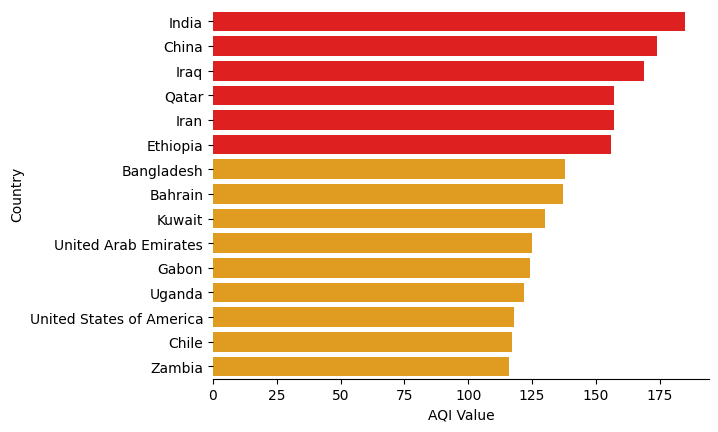

In [27]:
poorest_15 = np.round(avg.sort_values("AQI Value", ascending = False)).astype("int").head(15)
colors = ["Red"] * 6 + ["Orange"] * 9

sns.barplot(y = poorest_15.index , x = poorest_15["AQI Value"], palette = colors)
sns.despine(left = True)

## Situación general por países

Primero, tengamos una visión general de los datos.

Tracemos el recuento de estados: cuál es el mayor y cuál el peor.

In [7]:
today.groupby(['Status']).size()

Status
Good                              6245
Hazardous                           51
Moderate                          4793
Unhealthy                          569
Unhealthy for Sensitive Groups    1246
Very Unhealthy                      82
dtype: int64

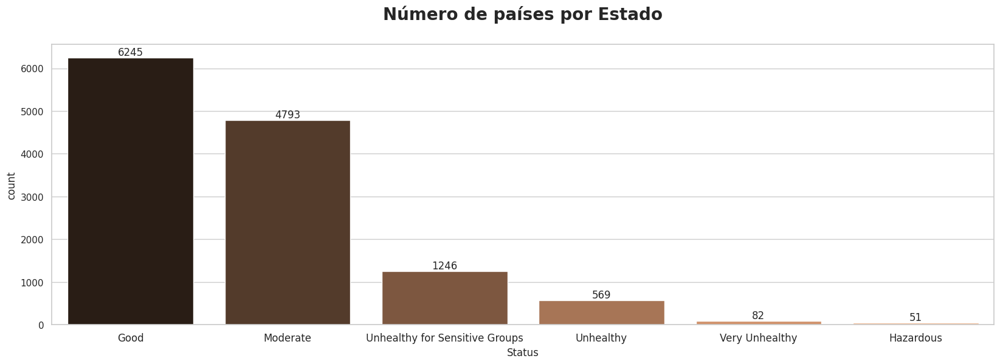

In [9]:
sns.set(rc={'figure.figsize':(20,6)})
sns.set_style("whitegrid")
plt.xticks(fontsize=12)
p=sns.countplot(today,x='Status',order=today.Status.value_counts().sort_values(ascending=False).index,palette='copper')
p.axes.set_title("Número de países por Estado\n",fontsize=20, fontweight='bold')

for container in p.containers:
    p.bar_label(container)

<Axes: xlabel='Status', ylabel='AQI Value'>

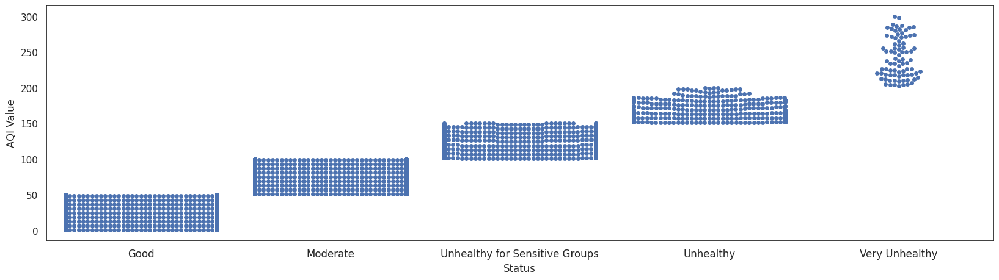

In [43]:
sns.set(rc={'figure.figsize':(20,5)})
sns.set_style("white")
plt.xticks(fontsize=12)
today['AQI Value']=pd.to_numeric(today['AQI Value'])
sns.swarmplot(data=today,x='Status',y='AQI Value',order=['Good', 'Moderate', 'Unhealthy for Sensitive Groups', 'Unhealthy', 'Very Unhealthy'])

Observaciones:
- La mayoría de los países se encuentran en estado bueno o moderado. Esa es una buena señal.
- Algunos países son insalubres.

# Distribución

Text(0.5, 1.0, 'Valores de distribución AQI')

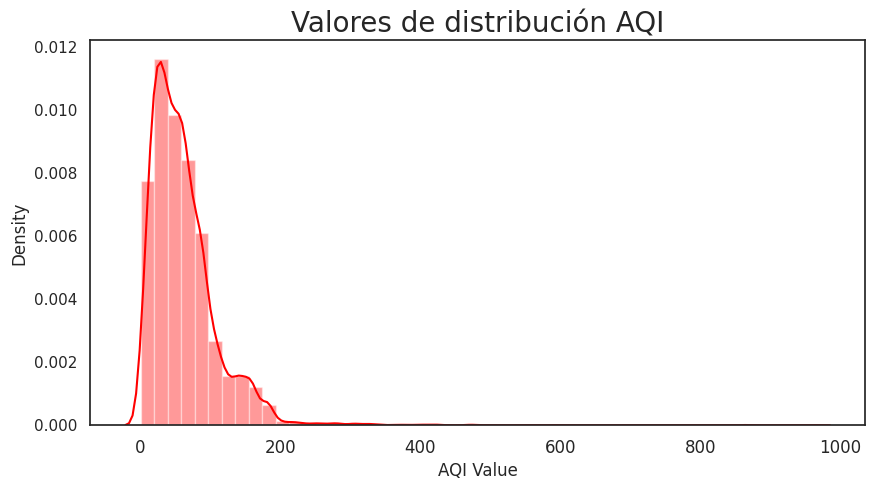

In [35]:
sns.set(rc={'figure.figsize':(10,5)})
sns.set_style("white")
plt.xticks(fontsize=12)
p=sns.distplot(today['AQI Value'],color='Red')
p.axes.set_title("Valores de distribución AQI",fontsize=20)

Observaciones:
- La gráfica confirma esa distribución sesgada.

# Países buenos y moderados

In [17]:
good=today[today['Status'].isin(['Good','Morderate'])]
print("Number of Good Countries:",len(good.Country))
print("Good Countries by AQL Values:",', '.join(good.Country))

Number of Good Countries: 6245
Good Countries by AQL Values: Albania, Austria, Azerbaijan, Belarus, Belize, Bermuda, Bolivia, Brunei, Bulgaria, Cambodia, Cape Verde, Cayman Islands, Costa Rica, Croatia, Cyprus, Denmark, Dominican Republic, Estonia, Finland, French Guiana, Gambia, Georgia, Gibraltar, Greece, Grenada, Guadeloupe, Guam, Guatemala, Honduras, Hong Kong, Iceland, Ireland, Ivory Coast, Jersey, Jordan, Kenya, Kosovo, Kyrgyzstan, Laos, Latvia, Liechtenstein, Lithuania, Luxembourg, Macao, Macedonia, Madagascar, Martinique, Moldova, Monaco, Montenegro, Myanmar, New Caledonia, New Zealand, Portugal, Puerto Rico, Reunion, San Marino, Senegal, Singapore, Slovenia, Sri Lanka, Sweden, Switzerland, Trinidad and Tobago, Ukraine, Venezuela, Vietnam, Zambia, Albania, Austria, Azerbaijan, Belarus, Belize, Bermuda, Bolivia, Brunei, Bulgaria, Cambodia, Cape Verde, Cayman Islands, Costa Rica, Croatia, Denmark, Dominican Republic, Estonia, Finland, French Guiana, Gambia, Georgia, Gibraltar, Gr

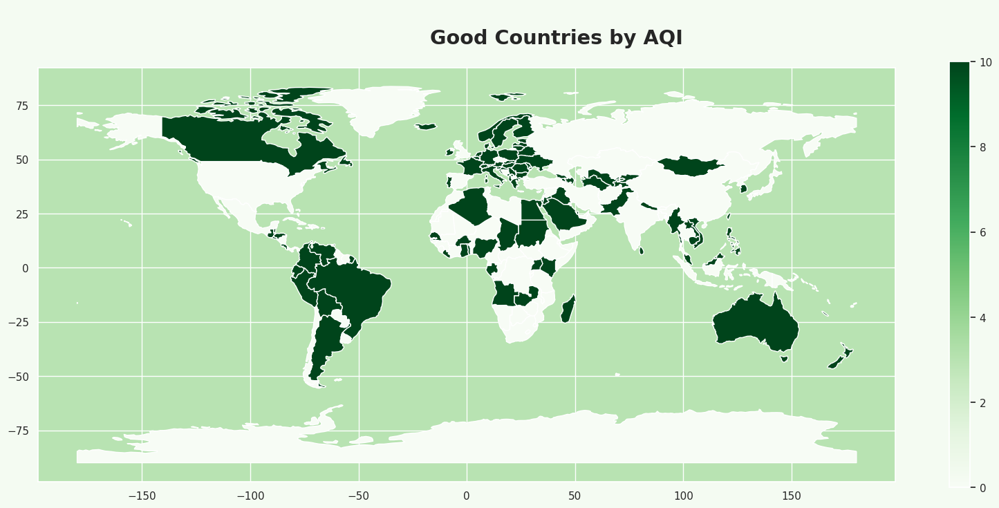

In [18]:
world = gpd.read_file(
    gpd.datasets.get_path('naturalearth_lowres')
)

values=[]

for i in list(world.name):
    if i in list(good.Country):
        values.append(10)
    else:
        values.append(0)

world['pop_est']=values
fig, ax = plt.subplots(figsize = (20,8), facecolor = plt.cm.Greens(.02))


fig.suptitle('\nGood Countries by AQI',
             fontsize = 'xx-large',
             fontweight = 'bold')

ax.set_facecolor(plt.cm.Greens(.3))
world.plot(column = 'pop_est',
           cmap = 'Greens',
           ax = ax,
           legend = True)

plt.show()

Observaciones:
- a mayoría de ellos están ubicados en Europa y el sudeste asiático.

Exploremos un poco más los países de riesgo.

# Países de riesgo.

In [19]:
risky=today[today['Status'].isin(['Unhealthy for Sensitive Groups'])]
print("Number of Risky Countries:",len(risky.Country))
print("Risky Countries by AQL Values:",', '.join(risky.Country))

Number of Risky Countries: 1246
Risky Countries by AQL Values: Angola, Bangladesh, Burkina Faso, Gabon, Ghana, Israel, Italy, Japan, Kuwait, Nigeria, Sudan, United States of America, Bangladesh, Chad, Gabon, Ghana, Israel, Italy, Mexico, Nigeria, Sudan, Togo, United States of America, Angola, Bangladesh, Central African Republic, Chile, Ethiopia, Gabon, Ghana, Italy, Mexico, Nigeria, Russia, Angola, Bangladesh, Brazil, Central African Republic, Chad, Ethiopia, Gabon, Ghana, Israel, Italy, Nigeria, Peru, Angola, Bangladesh, Central African Republic, Chile, Grenada, Iraq, Italy, Mexico, Nigeria, Peru, South Korea, Uzbekistan, Vietnam, Angola, Bangladesh, Brazil, Chile, China, France, Gabon, India, Iraq, Israel, Italy, Nigeria, Peru, Spain, Uganda, Angola, Bangladesh, Brazil, Chile, China, Ethiopia, Ghana, India, Italy, Kuwait, Nigeria, Peru, Russia, Spain, Sudan, Vietnam, Angola, Bangladesh, Chile, India, Kuwait, Nigeria, Spain, Turkmenistan, Angola, Bangladesh, Brazil, Burkina Faso, Chi

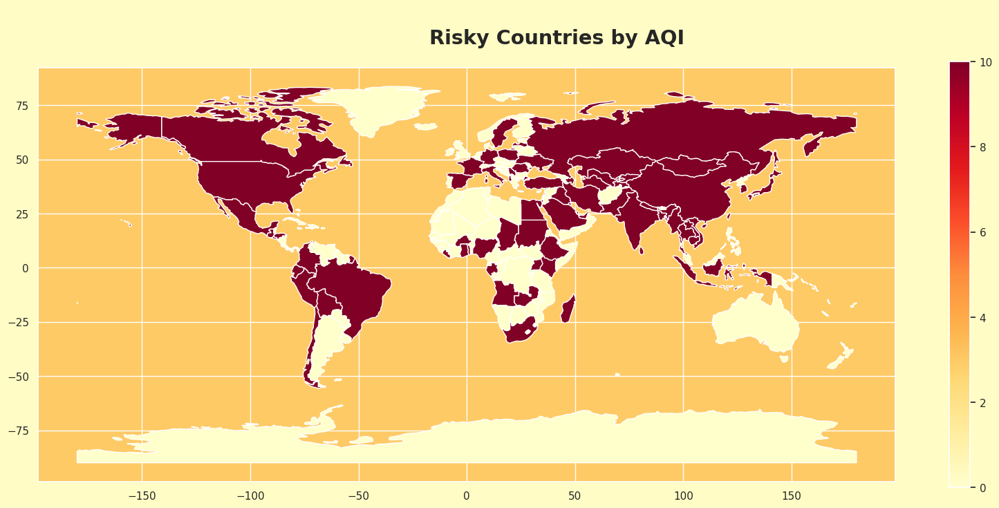

In [20]:
world = gpd.read_file(
    gpd.datasets.get_path('naturalearth_lowres')
)

values=[]

for i in list(world.name):
    if i in list(risky.Country):
        values.append(10)
    else:
        values.append(0)

world['pop_est']=values
fig, ax = plt.subplots(figsize = (20,8), facecolor = plt.cm.YlOrRd(.02))


fig.suptitle('\nRisky Countries by AQI',
             fontsize = 'xx-large',
             fontweight = 'bold')

ax.set_facecolor(plt.cm.YlOrRd(.3))
world.plot(column = 'pop_est',
           cmap = 'YlOrRd',
           ax = ax,
           legend = True)

plt.show()

Observaciones:
- La mayoría de ellos se encuentran en África y América del Norte, Asia.

Exploremos un poco más los países insalubres.

# Países insalubres

In [21]:
unhealthy=today[today['Status'].isin(['Unhealthy','Very Unhealthy'])]
print("Number of Unhealthy Countries:",len(unhealthy.Country))
print("Unhealthy Countries by AQL Values:",', '.join(unhealthy.Country))

Number of Unhealthy Countries: 651
Unhealthy Countries by AQL Values: Bahrain, Central African Republic, Chile, China, Ethiopia, India, Iran, Iraq, Qatar, Saudi Arabia, Togo, Uganda, Angola, Bahrain, Burkina Faso, Central African Republic, Chile, China, Ethiopia, India, Iran, Iraq, Kuwait, Qatar, Saudi Arabia, Uganda, Bahrain, China, India, Iran, Iraq, Kuwait, Qatar, Uganda, Bahrain, Burkina Faso, Chile, China, India, Iran, Iraq, Kuwait, Qatar, Uganda, Bahrain, Chad, China, Ethiopia, Gabon, India, Iran, Kuwait, Qatar, Sudan, Turkmenistan, Uganda, Bahrain, Ethiopia, Iran, Qatar, Iran, Iraq, Kenya, Qatar, Uganda, China, Iran, Iraq, Qatar, Uganda, United Arab Emirates, Zambia, China, Ethiopia, Iran, Iraq, Qatar, Uganda, Ethiopia, Gabon, Gibraltar, India, Iran, Iraq, Qatar, United Arab Emirates, China, Ethiopia, India, Iran, Qatar, Uganda, India, Iran, Qatar, Uganda, Angola, Gabon, India, Iran, Qatar, Uganda, China, Ethiopia, Gabon, India, Iran, Iraq, Qatar, Burkina Faso, China, Iran, Qata

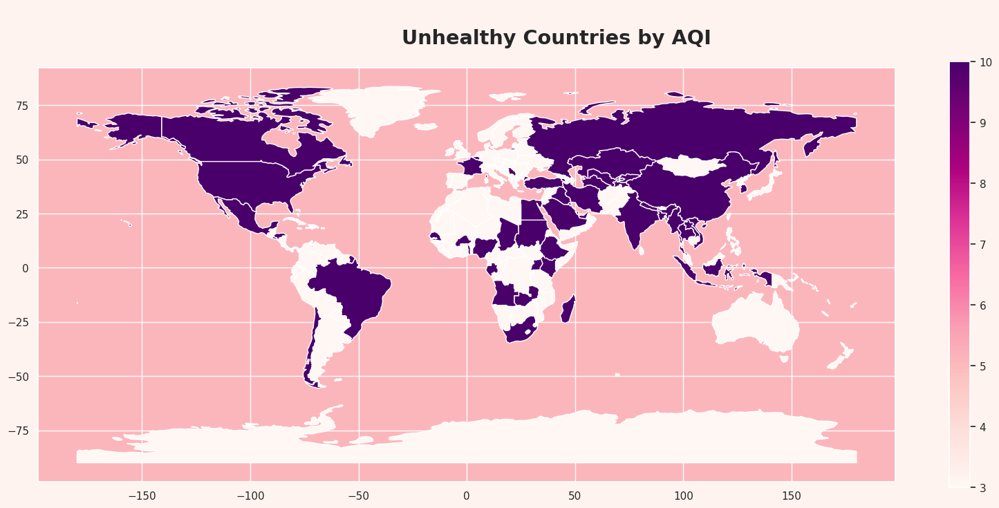

In [22]:
world = gpd.read_file(
    gpd.datasets.get_path('naturalearth_lowres')
)

values=[]

for i in list(world.name):
    if i in list(unhealthy.Country):
        values.append(10)
    else:
        values.append(3)

world['pop_est']=values
fig, ax = plt.subplots(figsize = (20,8), facecolor = plt.cm.RdPu(.02))
fig.suptitle('\nUnhealthy Countries by AQI',
             fontsize = 'xx-large',
             fontweight = 'bold')
ax.set_facecolor(plt.cm.RdPu(.3))
world.plot(column = 'pop_est',
           cmap = 'RdPu',
           ax = ax,
           legend = True)

plt.show()

Observaciones:
- La mayoría de ellos están ubicados en África, Medio Oriente y el sur de Asia.

# Distribuciones de cada grupo

<Axes: xlabel='Status', ylabel='AQI Value'>

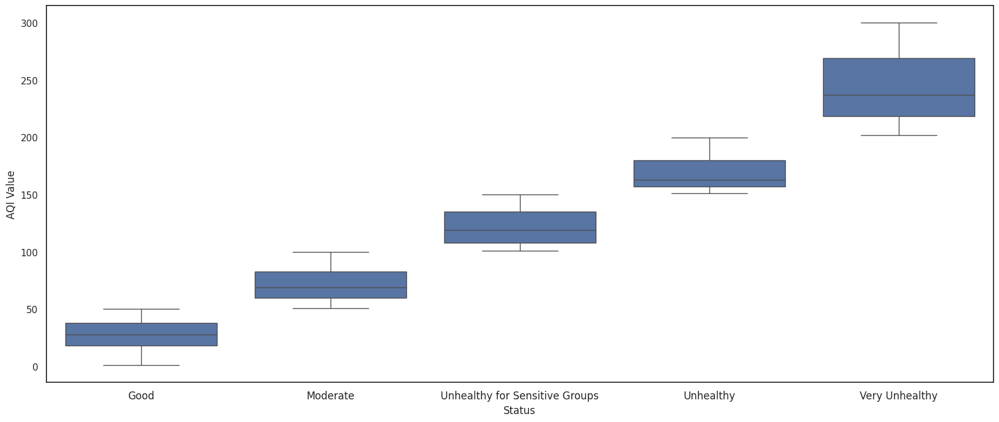

In [13]:
sns.set(rc={'figure.figsize':(20,8)})
sns.set_style("white")
plt.xticks(fontsize=12)
today['AQI Value']=pd.to_numeric(today['AQI Value'])
sns.boxplot(data=today,x='Status',y='AQI Value',order=['Good', 'Moderate', 'Unhealthy for Sensitive Groups', 'Unhealthy', 'Very Unhealthy'])

<Axes: xlabel='Status', ylabel='AQI Value'>

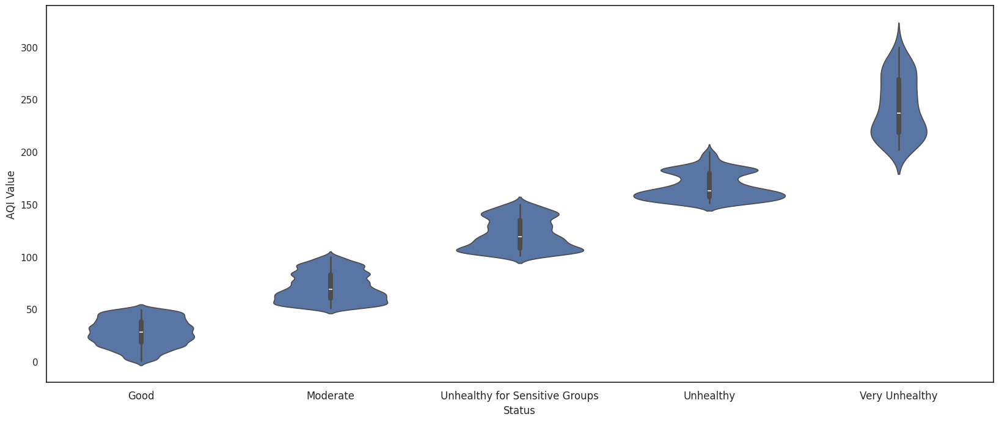

In [14]:
sns.set(rc={'figure.figsize':(20,8)})
sns.set_style("white")
plt.xticks(fontsize=12)
today['AQI Value']=pd.to_numeric(today['AQI Value'])
sns.violinplot(data=today,x='Status',y='AQI Value',order=['Good', 'Moderate', 'Unhealthy for Sensitive Groups', 'Unhealthy', 'Very Unhealthy'])

Observaciones:
- No saludable: el estado tiene una mediana más baja en comparación con otros.

Conclusión:
- Asia parece tener el aire más contaminado.
- Europa parece tener un aire moderadamente contaminado.
- África tiene una condición mixta, basada en la urbanización y la industrialización, supongo.
- La mayoría de los países se encuentran en estado bueno o moderado. Esa es una buena señal.
- Algunos países son insalubres.